In [ ]:
# The Python SDKのインストール
# pip install -q -U google-generativeai

In [44]:
import textwrap
import os
from dotenv import load_dotenv

import google.generativeai as genai


from IPython.display import display
from IPython.display import Markdown

# 初期設定

In [45]:
# マークダウンに変換する関数
def to_markdown(text):
    text = text.replace('•', '  *')
    return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))

In [46]:
load_dotenv('./.env')
GEMINI_API_KEY = os.environ['GEMINI_API_KEY']
genai.configure(api_key=GEMINI_API_KEY)

# 利用できるモデル
- １分間に60リクエストまで無料
- gemini-pro：テキストのみ
- gemini-pro-vision：テキストとイメージ

In [12]:
for m in genai.list_models():
  if 'generateContent' in m.supported_generation_methods:
    print(m.name)

models/gemini-pro
models/gemini-pro-vision


# text model

In [13]:
model = genai.GenerativeModel('gemini-pro')

In [14]:
%%time
response = model.generate_content("What is the meaning of life?")

CPU times: user 7.31 ms, sys: 10.6 ms, total: 17.9 ms
Wall time: 9.05 s


In [17]:
to_markdown(response.text)

> The meaning of life is a profound and philosophical question that has fascinated humans for millennia. There is no one definitive answer that satisfies everyone, as the meaning of life is personal and subjective. However, there are several perspectives and common themes that people have explored and discussed throughout history:
> 
> **1. Purpose and Fulfillment**:
>    For many, finding meaning in life involves identifying their purpose and working towards achieving it. This purpose can be personal, such as raising a family or pursuing a creative passion, or it can be broader, like making a positive impact on society or the world. A sense of purpose can provide direction and motivation, leading to a feeling of fulfillment and accomplishment.
> 
> **2. Relationships and Connections**:
>    Humans are social creatures, and strong relationships with family, friends, and loved ones can significantly contribute to a meaningful life. Nurturing these connections, providing support and receiving it in return, and sharing experiences can bring joy, love, and belonging.
> 
> **3. Personal Growth and Development**:
>    Embracing personal growth and development can give life meaning. This could involve learning new skills, facing challenges, overcoming obstacles, and expanding one's knowledge and perspective. Continuously striving to become a better person, physically, mentally, or spiritually, can lead to a sense of accomplishment and fulfillment.
> 
> **4. Contribution to Society**:
>    Many individuals find meaning in contributing to the well-being of others and society as a whole. This could involve volunteering, working in a helping profession, or simply performing acts of kindness. Helping others and making a positive impact can create a sense of purpose and significance.
> 
> **5. Creativity and Expression**:
>    For some, expressing oneself creatively can be a powerful way to find meaning in life. Whether through art, music, writing, or other forms of creative expression, engaging in creative activities can allow individuals to communicate their thoughts, emotions, and unique perspectives.
> 
> **6. Spiritual and Religious Beliefs**:
>    For many people, spiritual or religious beliefs provide a framework for understanding the meaning of life. Different religions and spiritual traditions offer explanations of the origins, purpose, and ultimate destiny of human existence. Following religious or spiritual practices and rituals can bring comfort, guidance, and a sense of connection to a higher power.
> 
> **7. Unique Experiences and Perspectives**:
>    Life's meaning can be found in the unique experiences and perspectives each individual encounters. Embracing diversity, traveling, learning about different cultures, and pushing oneself outside of one's comfort zone can broaden one's horizons and lead to a deeper understanding of the world and one's place in it.
> 
> Ultimately, the search for meaning in life is an ongoing personal journey. It is not something that can be attained once and for all, but rather a continuous process of exploration, reflection, and growth.

In [43]:
%%time
response = model.generate_content("What is the meaning of life?", stream=True)

for chunk in response:
  print(chunk.text)
  print("_"*80)

The meaning of life is a complex and multifaceted question that has been pondered by philosophers
________________________________________________________________________________
, theologians, and scientists for centuries. There is no single, universally accepted answer, as the meaning of life is subjective and personal to each individual. However,
________________________________________________________________________________
 several common themes and perspectives on the meaning of life emerge from various philosophical, religious, and scientific traditions.

1. **Purpose and Fulfillment:**

   Many people find meaning in life by pursuing goals, passions, or activities that bring them a sense of purpose and fulfillment. This can include creative endeavors, professional achievements,
________________________________________________________________________________
 personal growth, or contributing to the well-being of others.

2. **Relationships and Connections:**

   Strong and mean

# img

In [ ]:
import PIL.Image

img = PIL.Image.open('./test_img/img1.jpg')
img

In [28]:
model = genai.GenerativeModel('gemini-pro-vision')

In [29]:
response = model.generate_content(img)

to_markdown(response.text)

>  This is a photo of a foggy forest.

# text & img

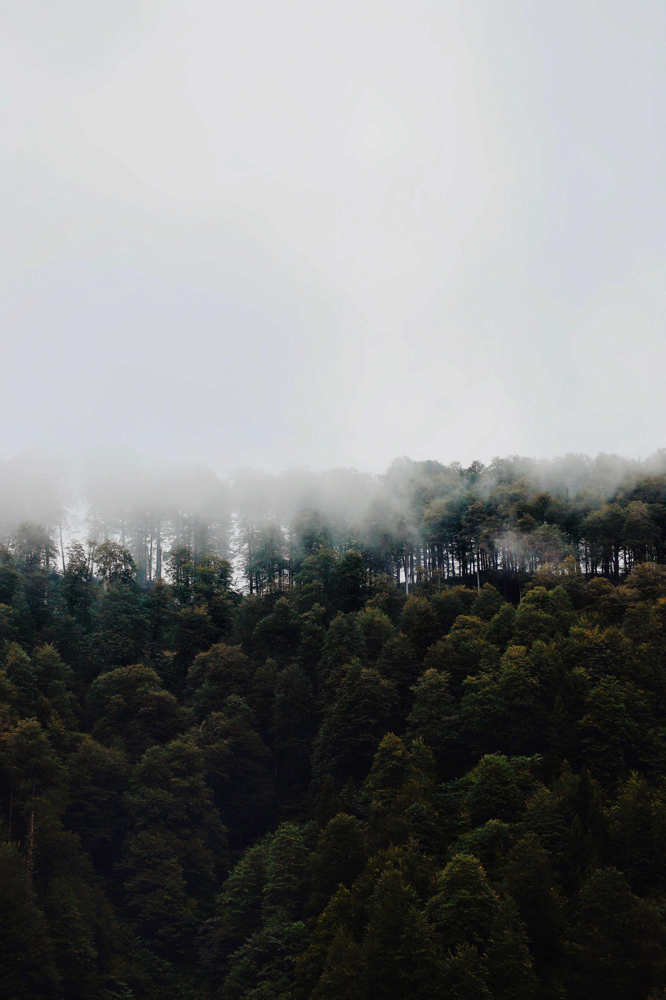

In [59]:
import PIL.Image

img = PIL.Image.open('./test_img/img1.jpg')
img

In [60]:
model = genai.GenerativeModel('gemini-pro-vision')

In [61]:
response = model.generate_content(["Write an article based on this picture. Like a good forest.", img], stream=True)
response.resolve()

In [62]:
to_markdown(response.text)

>  The picture shows a forest on a foggy day. The trees are tall and straight, and the leaves are a deep green. The forest is dense, and the trees are close together. The ground is covered with a thick layer of leaves. The forest is silent, and the only sound is the occasional rustle of leaves in the wind. The picture is peaceful and serene, and it captures the beauty of the natural world.
> 
> The forest is an important ecosystem. It provides a home for many different plants and animals. It also helps to clean the air and water, and it provides a place for people to relax and enjoy the outdoors. Forests are important to the health of the planet, and we must do our part to protect them.

# chat テキストのみ対応

In [35]:
model = genai.GenerativeModel('gemini-pro')
chat = model.start_chat(history=[])
chat

In [36]:
response = chat.send_message("In one sentence, explain how a computer works to a young child.")
to_markdown(response.text)

> A computer is a magical machine that can help you play games, watch videos, and learn new things by using its brain, called a processor, to follow your instructions.

In [37]:
response = chat.send_message("In one sentence, explain how a computer works to a young child.")
to_markdown(response.text)

> A computer is a special machine that can do lots of things for you by following your instructions using its clever brain, called a processor.

In [38]:
chat.history

[parts {
   text: "In one sentence, explain how a computer works to a young child."
 }
 role: "user",
 parts {
   text: "A computer is a magical machine that can help you play games, watch videos, and learn new things by using its brain, called a processor, to follow your instructions."
 }
 role: "model",
 parts {
   text: "In one sentence, explain how a computer works to a young child."
 }
 role: "user",
 parts {
   text: "A computer is a special machine that can do lots of things for you by following your instructions using its clever brain, called a processor."
 }
 role: "model"]

In [39]:
response = chat.send_message("Okay, how about a more detailed explanation to a high schooler?", stream=True)

for chunk in response:
  print(chunk.text)
  print("_"*80)

A computer is an electronic device that can be programmed to carry out a set of
________________________________________________________________________________
 instructions. It consists of five main components: the processor, memory, storage, input devices, and output devices. The processor, or central processing unit (CPU
________________________________________________________________________________
), is the brain of the computer and controls all of its operations. It reads and executes instructions from memory, performs calculations, and manages the flow of data. Memory, or random access memory (RAM), stores data and instructions that are being currently processed by the CPU. Storage, or secondary storage, such as hard disk
________________________________________________________________________________
 drives or solid-state drives, stores data and instructions that are not currently being processed but can be accessed by the CPU when needed. Input devices, such as keyboards an

In [40]:
for message in chat.history:
  display(to_markdown(f'**{message.role}**: {message.parts[0].text}'))

> **user**: In one sentence, explain how a computer works to a young child.

> **model**: A computer is a magical machine that can help you play games, watch videos, and learn new things by using its brain, called a processor, to follow your instructions.

> **user**: In one sentence, explain how a computer works to a young child.

> **model**: A computer is a special machine that can do lots of things for you by following your instructions using its clever brain, called a processor.

> **user**: Okay, how about a more detailed explanation to a high schooler?

> **model**: A computer is an electronic device that can be programmed to carry out a set of instructions. It consists of five main components: the processor, memory, storage, input devices, and output devices. The processor, or central processing unit (CPU), is the brain of the computer and controls all of its operations. It reads and executes instructions from memory, performs calculations, and manages the flow of data. Memory, or random access memory (RAM), stores data and instructions that are being currently processed by the CPU. Storage, or secondary storage, such as hard disk drives or solid-state drives, stores data and instructions that are not currently being processed but can be accessed by the CPU when needed. Input devices, such as keyboards and mice, allow the user to interact with the computer and provide it with data. Output devices, such as monitors and printers, display or print data from the computer to the user.

# 質問実験

In [49]:
model = genai.GenerativeModel('gemini-pro')

In [50]:
# 実験1
text = '熱があるので会社を休むためのメールを考えて。本当に熱があるわけではありません。'
response = model.generate_content(text)
to_markdown(response.text)

> 件名：本日欠勤のお知らせ
> 
> お世話になっております。
> [あなたの名前]と申します。
> 
> 本日は、熱があるため、欠勤させていただきます。
> ご迷惑をおかけして申し訳ございません。
> 
> また、熱が下がり次第、出社いたします。
> 
> 何卒ご理解のほど、よろしくお願いいたします。
> 
> 敬具
> 
> [あなたの名前]

In [51]:
# 実験2
text = 'pythonでirisデータを読み込み、簡単な分析を行うプログラムを考えて。'
response = model.generate_content(text)
to_markdown(response.text)

> ```python
> import pandas as pd
> import matplotlib.pyplot as plt
> import seaborn as sns
> 
> # Irisデータを読み込む
> iris = pd.read_csv('iris.csv')
> 
> # 各特徴の統計量を表示
> print(iris.describe())
> 
> # 特徴の相関関係を表示
> print(iris.corr())
> 
> # ヒストグラムを表示
> iris.hist()
> plt.show()
> 
> # 散布図を表示
> sns.pairplot(iris, hue='species')
> plt.show()
> 
> # 各特徴を基準にした箱ひげ図を表示
> iris.groupby('species').boxplot()
> plt.show()
> ```